<a id='top'></a>
# Table of contents

[Importing libraries, settings, and data](#import)

[Data preparation](#prep)

[The elbow technique](#elbow)

[k-means clustering](#cluster)

BONUS

- [Using scaled data to see the difference](#stand)


<a id='import'></a>
# Importing libraries, settings, and data

[Back to top](#top)

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import os
import sklearn
from pylab import rcParams
from sklearn.cluster import KMeans
import pylab as pl 
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
import sklearn
from sklearn import preprocessing
from sklearn.preprocessing import scale
import warnings
warnings.filterwarnings("ignore")

In [2]:
%matplotlib inline
rcParams['figure.figsize']=14,7
sns.set_style('whitegrid')

In [3]:
path=r'C:\Users\frauz\Documents\Python Projects\Final Project\Data\Data Prepared' #creating a path

#Importing the data

df=pd.read_pickle(os.path.join(path, 'capnoncap_market_level_data_final.pkl')) 

<a id='prep'></a>
# Data preparation

[Back to top](#top)

In [97]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 193836 entries, 0 to 193835
Data columns (total 21 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   iso                      193836 non-null  object        
 1   date                     193836 non-null  datetime64[ns]
 2   currency                 193836 non-null  object        
 3   capital_market           193836 non-null  object        
 4   product_name             193836 non-null  object        
 5   price_unit               193836 non-null  float64       
 6   usdprice_unit            193836 non-null  float64       
 7   year                     193836 non-null  int32         
 8   population               161482 non-null  float64       
 9   millions_undernourished  135049 non-null  float64       
 10  country                  193836 non-null  object        
 11  estim_earnings           63673 non-null   float64       
 12  year_month      

In [98]:
data=df[['usdprice_unit',
            'population',
            '%_undernourished',
            'inflation',
            'gdp_pcapita',
            'price_index',
            'affordability_index',
            '%_annual_growth']]

In [99]:
data.head()

,usdprice_unit,population,%_undernourished,inflation,gdp_pcapita,price_index,affordability_index,%_annual_growth
0,0.3048,NaN,NaN,NaN,NaN,28.52,NaN,13.11
1,0.2860,NaN,NaN,NaN,NaN,26.98,NaN,13.11
2,0.2482,NaN,NaN,NaN,NaN,23.52,NaN,13.11
3,0.2733,NaN,NaN,NaN,NaN,25.84,NaN,13.11
4,0.3478,NaN,NaN,NaN,NaN,32.88,NaN,13.11


After several attempts to identify patterns using centroid-based clustering, I've concluded that the best results can be achieved after scaling the data. I'm also removing the outliers that make scatterplots difficult to read.

In [100]:
# Removing missing values

data.dropna(inplace=True)

In [101]:
# Removing outliers

data=data[(data['%_annual_growth']<1000)&
             (data['price_index']<500)&
             (data['affordability_index']<20000)]

In [102]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 42192 entries, 167 to 193835
Data columns (total 8 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   usdprice_unit        42192 non-null  float64
 1   population           42192 non-null  float64
 2   %_undernourished     42192 non-null  float64
 3   inflation            42192 non-null  float64
 4   gdp_pcapita          42192 non-null  float64
 5   price_index          42192 non-null  float64
 6   affordability_index  42192 non-null  float64
 7   %_annual_growth      42192 non-null  float64
dtypes: float64(8)
memory usage: 2.9 MB


In [72]:
# Normalizing the variables in order to plot the distribution

var=data.values # extracting values from the columns

scaler=preprocessing.MinMaxScaler() # scaling the data in each column
var_scaled=scaler.fit_transform(var)

data_scaled=pd.DataFrame(var_scaled) # creating a new dataframe of scaled data
data_scaled.columns=data.columns.to_list()

In [73]:
# Using plotly to create an interactive table

table2=go.Figure(data=[go.Table(
    header=dict(values=list(data_scaled.columns),
                fill_color='paleturquoise',
                align='left'),
    cells=dict(values=data_scaled.transpose().values.tolist(),
               fill_color='lavender',
               align='left'))
])

table2.show()

In [74]:
#Defining the range of clusters

nr_clust = range(1, 10) 

#Defining the number of clusters

kmeans1 = [KMeans(n_clusters=i) for i in nr_clust] 

In [75]:
# Calculating the rate of variation for each number of clusters

score1 = [kmeans1[i].fit(data_scaled).score(data_scaled) for i in range(len(kmeans1))] # Creates a score that represents 


score1

[-4213.662016374212,
 -2219.972528839047,
 -1646.6893658082936,
 -1093.7737714918592,
 -976.8894062846326,
 -905.9554908897334,
 -791.4824561405115,
 -729.8831378012565,
 -678.6981199042599]

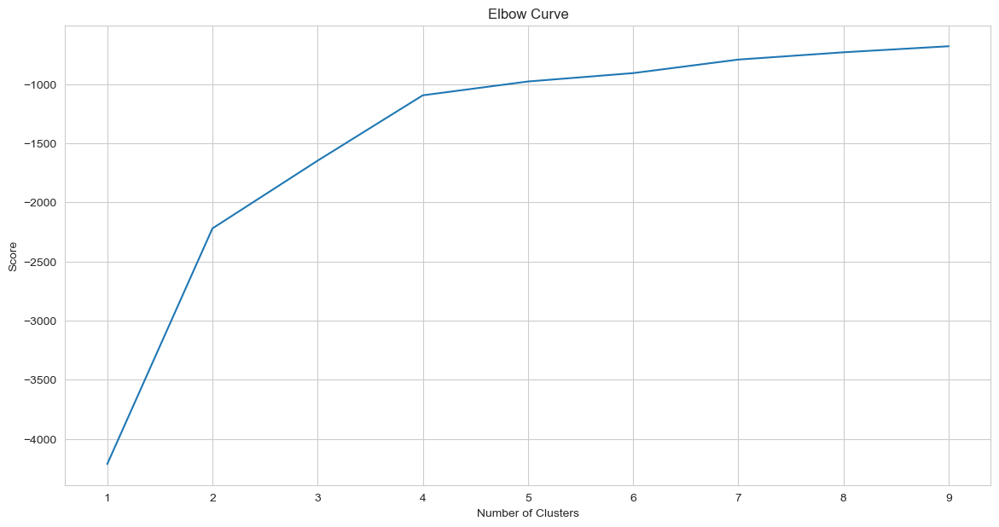

In [76]:
# Ploting the elbow curve

pl.plot(nr_clust, score1)
pl.xlabel('Number of Clusters')
pl.ylabel('Score')
pl.title('Elbow Curve')
pl.show()

Now that the data is scaled, the elbow curve looks much smoother. I decided to look at 4 clusters since the difference between 3 and 4 clusters in terms of variation is significantly higher than between 4 and 5 clusters.

In [77]:
# Creating the k-means object

kmeans2 = KMeans(n_clusters = 4) 

In [78]:
kmeans2.fit(data_scaled)

KMeans(n_clusters=4)

In [79]:
data_scaled['cluster']=kmeans2.fit_predict(data_scaled)

In [80]:
data_scaled['cluster'].value_counts()

0    20599
2    14245
1     6723
3      625
Name: cluster, dtype: int64

In [103]:
data_scaled.to_csv(os.path.join(path, 'clustered_data.csv'))

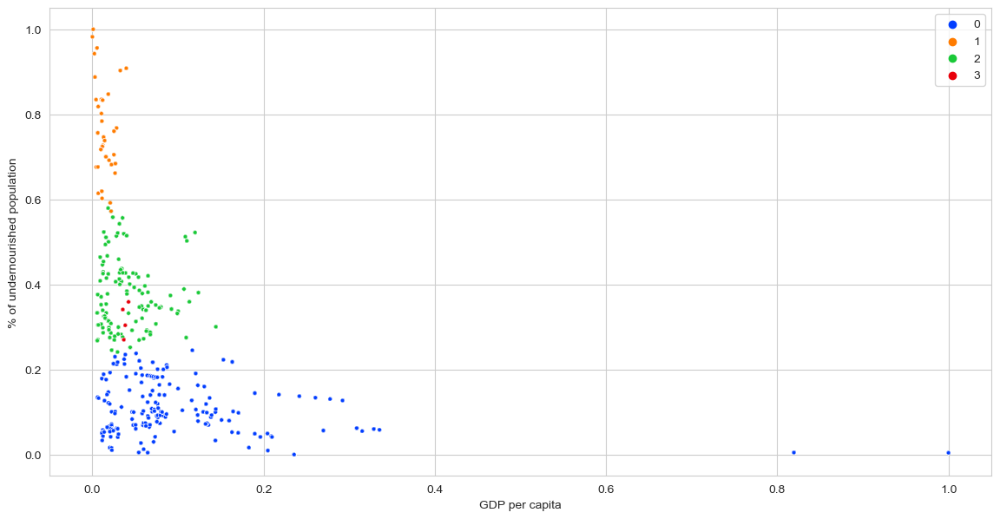

In [81]:
# Ploting the clusters

scatter10 = sns.scatterplot(x=data_scaled['gdp_pcapita'], y=data_scaled['%_undernourished'], hue=kmeans2.labels_, palette='bright', s=10) 

plt.xlabel('GDP per capita')
plt.ylabel('% of undernourished population') 
plt.show()

I can see that one of the clusters includes the observations with the highest percentage of undernourished people. I can already see that this cluster is also associated with low GDP per capita. I'm curious to see other characteristics of this cluster.

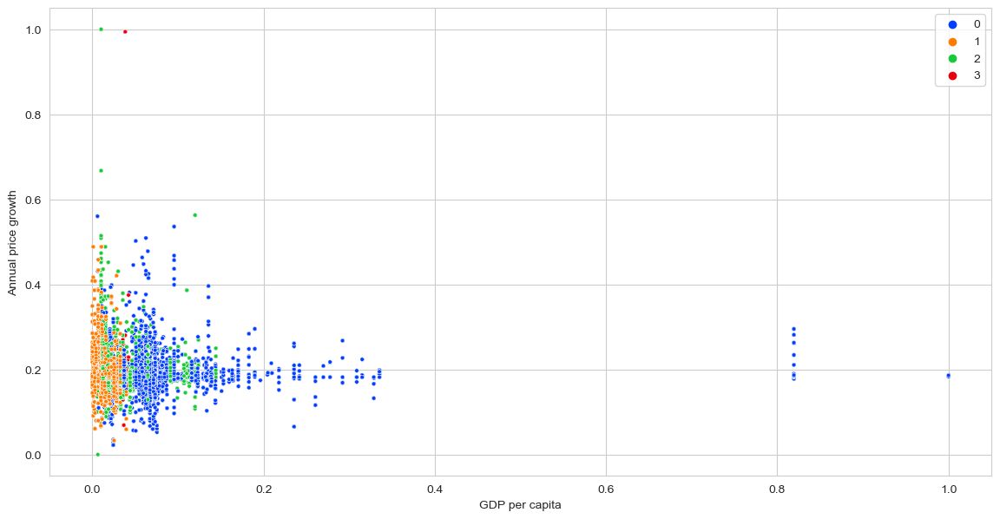

In [82]:
# Ploting the clusters

scatter11 = sns.scatterplot(x=data_scaled['gdp_pcapita'], y=data_scaled['%_annual_growth'], hue=kmeans2.labels_, palette='bright', s=10) 

plt.xlabel('GDP per capita')
plt.ylabel('Annual price growth') 
plt.show()

The cluster of values associated with the highest percentage of undernourished people is also associated with relatively high price volatility. However, I can observe even higher fluctuations in price in other clusters as well.  

In [83]:
# Plotting variable variations in a 3-d scatterplot

d_scatter_1 = px.scatter_3d(data_scaled, x='usdprice_unit', y='%_undernourished', z='population', color='cluster')
d_scatter_1.show()

Using a 3D plot I can look at different values in combination.

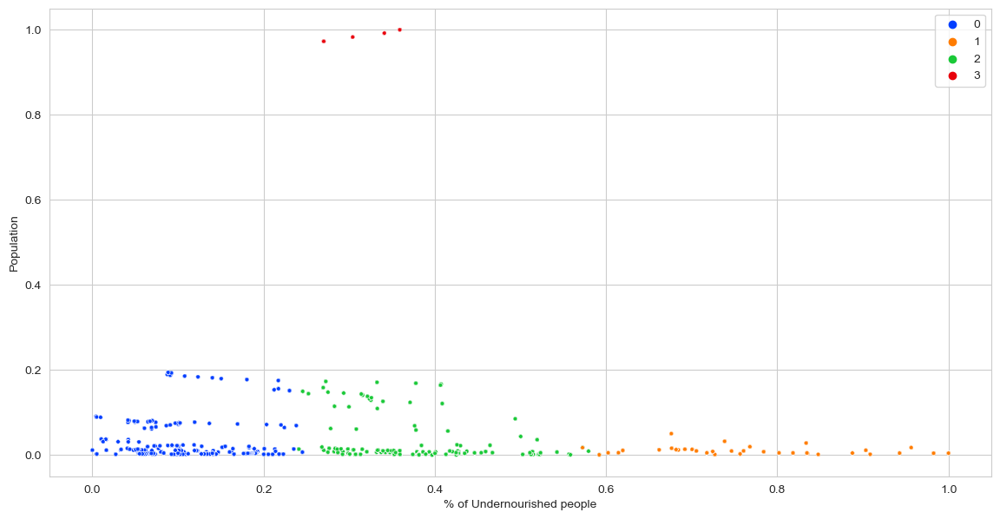

In [84]:
# Ploting the clusters

scatter13 = sns.scatterplot(x=data_scaled['%_undernourished'], y=data_scaled['population'], hue=kmeans2.labels_, palette='bright', s=10) 

plt.xlabel('% of Undernourished people')
plt.ylabel('Population') 
plt.show()

The cluster with the highest percentage of undernourished people is also associated with a small population size.  
I can also see that the fourth-smallest cluster is again represented by a single country, India.

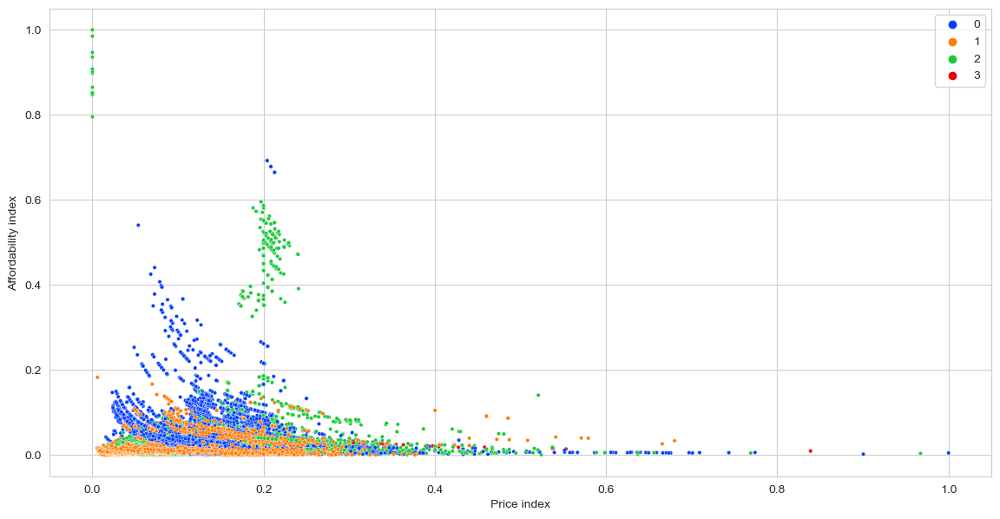

In [89]:
# Plotting the clusters

scatter14 = sns.scatterplot(x=data_scaled['price_index'], y=data_scaled['affordability_index'], hue=kmeans2.labels_, palette='bright', s=10) 

plt.xlabel('Price index')
plt.ylabel('Affordability index') 
plt.show()

The cluster with the highest percentage of undernourished people doesn't have any clear pattern associated with a price index variable. At the same time, it has lower food affordability in general compared to the other clusters.

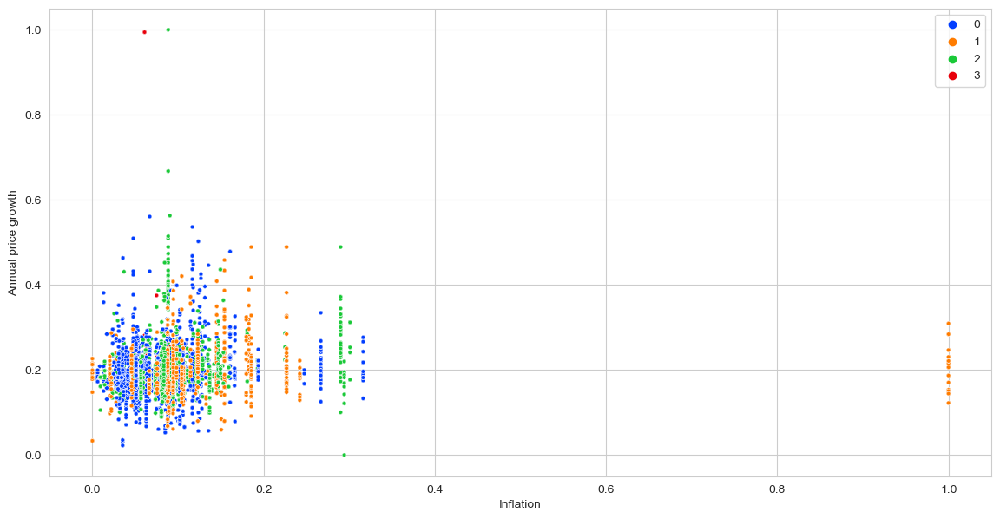

In [88]:
# Plotting the clusters

scatter15 = sns.scatterplot(x=data_scaled['inflation'], y=data_scaled['%_annual_growth'], hue=kmeans2.labels_, palette='bright', s=10) 

plt.xlabel('Inflation')
plt.ylabel('Annual price growth') 
plt.show()

The cluster with the highest percentage of undernourished people has the lowest as well as the highest inflation values, demonstrating that the official inflation rate can't give us any insight into the real-life food security situation. 

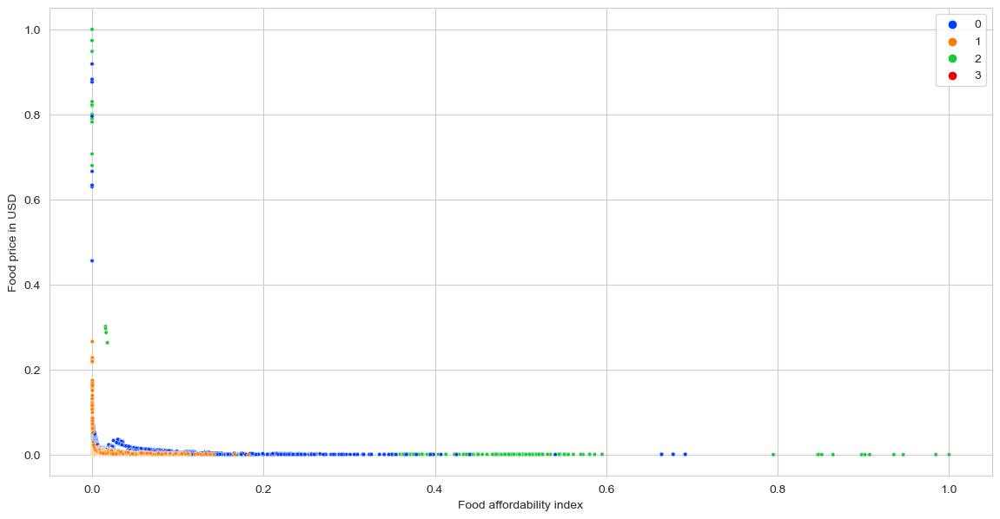

In [86]:
# Plotting the clusters

scatter16 = sns.scatterplot(x=data_scaled['affordability_index'], y=data_scaled['usdprice_unit'], hue=kmeans2.labels_, palette='bright', s=10) 

plt.xlabel('Food affordability index')
plt.ylabel('Food price in USD') 
plt.show()

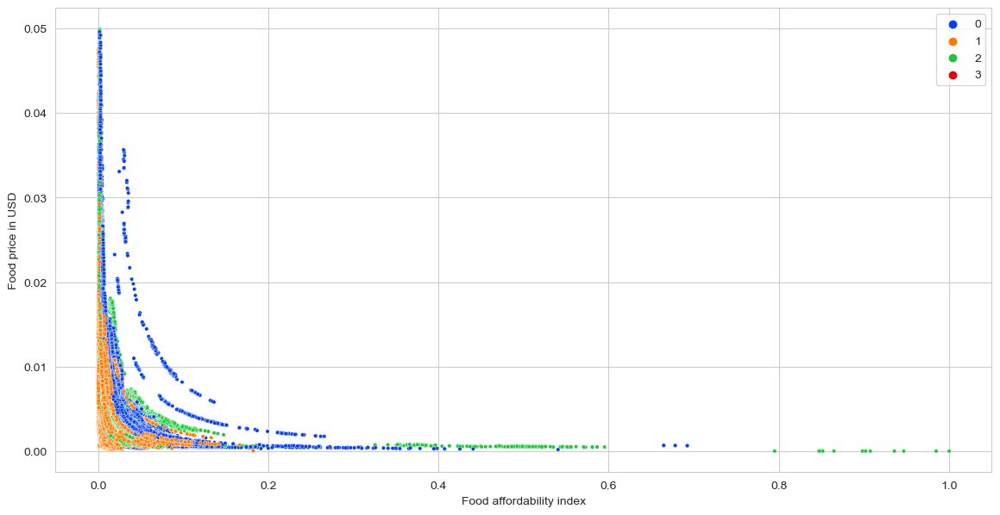

In [87]:
# Taking a closer look at the same plot

scatter18 = sns.scatterplot(x=data_scaled['affordability_index'], y=data_scaled['usdprice_unit'][data_scaled['usdprice_unit']<0.05], hue=kmeans2.labels_, palette='bright', s=10) 

plt.xlabel('Food affordability index')
plt.ylabel('Food price in USD') 
plt.show()

In [91]:
# Calculating statistics for each cluster

data_scaled.groupby('cluster').agg({'%_annual_growth':['mean', 'median'], 
                         '%_undernourished':['mean', 'median'], 
                         'population':['mean', 'median'],
                          'affordability_index':['mean', 'median'],
                          'usdprice_unit':['mean', 'median'],
                          'gdp_pcapita':['mean', 'median'],
                          'inflation':['mean', 'median'],
                          'price_index':['mean', 'median']})

%_annual_growth           %_undernourished           population  \
                   mean    median             mean    median       mean   
cluster                                                                   
0              0.192809  0.185142         0.100272  0.078879   0.036487   
1              0.203599  0.191706         0.785735  0.784120   0.009887   
2              0.203356  0.188148         0.381959  0.359115   0.028413   
3              0.213465  0.192319         0.318864  0.341096   0.986866   

                  affordability_index           usdprice_unit            \
           median                mean    median          mean    median   
cluster                                                                   
0        0.012082            0.024962  0.016546      0.007436  0.004580   
1        0.004916            0.011997  0.007056      0.005746  0.003058   
2        0.007490            0.028573  0.014507      0.007307  0.004195   
3        0.992056            0.024850  0.022047      0.004367  0.002918   

        gdp_pcapita           inflation           price_index            
               mean    median      mean    median        mean    median  
cluster                                                                  
0          0.070305  0.059513  0.074467  0.061794    0.135519  0.131611  
1          0.011140  0.010664  0.132532  0.104337    0.097673  0.081350  
2          0.039701  0.033107  0.088601  0.081822    0.140195  0.135032  
3          0.038177  0.036804  0.072623  0.074892    0.178038  0.167375

The most significant differences can be observed across the percentage of undernourished people, GDP per capita, and food affordability index.

### Conclusion

When using scaled data, the algorithm has demonstrated a much more interesting pattern across clusters. The cluster associated with the highest percentage of undernourished people is the one I'm most interested in. Using the k-means algorithm helped me discover that the highest percentage of undernourished people is associated with low population size, low GDP per capita, high price volatility, low food affordability, and a small to medium basket size. However, neither the official inflation rate nor actual food prices or price index can give us an understanding of the food security situation in the country or the rate at which people are at risk of hunger. 